In [1]:
from phomo import Master, Pool, Mosaic

from PIL import Image
from random import sample
from pathlib import Path

/home/lcoyle/.cache/pypoetry/virtualenvs/phomo-pX3Qwu7w-py3.12/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Face dataset from:

https://susanqq.github.io/UTKFace/

dl link: https://drive.google.com/drive/folders/0BxYys69jI14kU0I1YUQyY1ZDRUE?resourcekey=0-01Pth1hq20K4kuGVkp3oBw

Download and extract to `faces/` folder.

Dataset contains 9780 200x200 images of faces.

# Performence trick

**For best performance use the `Mosaic.d_matrix_cuda` method to compute the distance matrix. It requires installing with `pip install 'phomo[cuda]'`. If you do not have a GPU or it is incompatible with `cuda`, consider using the trick shown in this notebook.**

This notebook shows a trick to compute the distance matrix on a smaller master/pool set but then build the mosaic image with higher resolution images.

### Pools

In [2]:
small_pool = Pool.from_dir("faces/", crop_ratio=1, tile_size=(20, 20))
large_pool = Pool.from_dir("faces/", crop_ratio=1, tile_size=(200, 200))

Loading tiles: 100%|██████████████████████████████████████████████████████████████████████████████████████████████| 9780/9780 [00:03<00:00, 2862.56it/s]


### Master images

A random face from the dataset

In [3]:
master_file = sample(list(Path("faces").glob('*')), 1)[0]

In [4]:
small_master = Master.from_file(master_file, img_size=(400, 400))
large_master = Master.from_file(master_file, img_size=(4000, 4000))

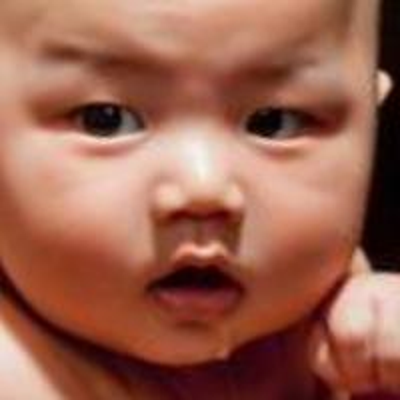

In [5]:
small_master.img

### Mosaics

In [6]:
small_mosaic = Mosaic(small_master, small_pool)
large_mosaic = Mosaic(large_master, large_pool)

Store the small image distance matrix.

In [7]:
d_matrix = small_mosaic.d_matrix()

Building distance matrix: 100%|███████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:11<00:00, 33.68it/s]


dmatrix (400, 9780)


Building mosaic: 100%|████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:00<00:00, 256023.44it/s]


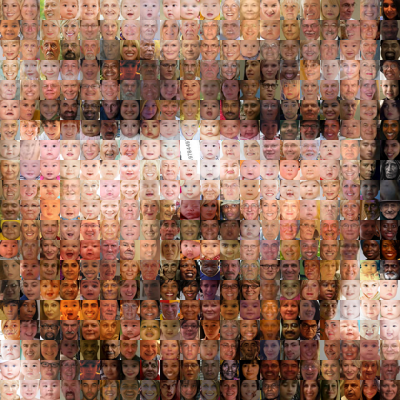

In [8]:
small_mosaic_img = small_mosaic.build(d_matrix=d_matrix)
small_mosaic_img

In [9]:
small_mosaic_img.size

(400, 400)

Avoid computing the distance matrix with high resolution images, take the matrix from the small images.

In [10]:
large_mosaic_img = large_mosaic.build(d_matrix=d_matrix)

dmatrix (400, 9780)


Building mosaic: 100%|██████████████████████████████████████████████████████████████████████████████████████████████| 400/400 [00:00<00:00, 7950.04it/s]


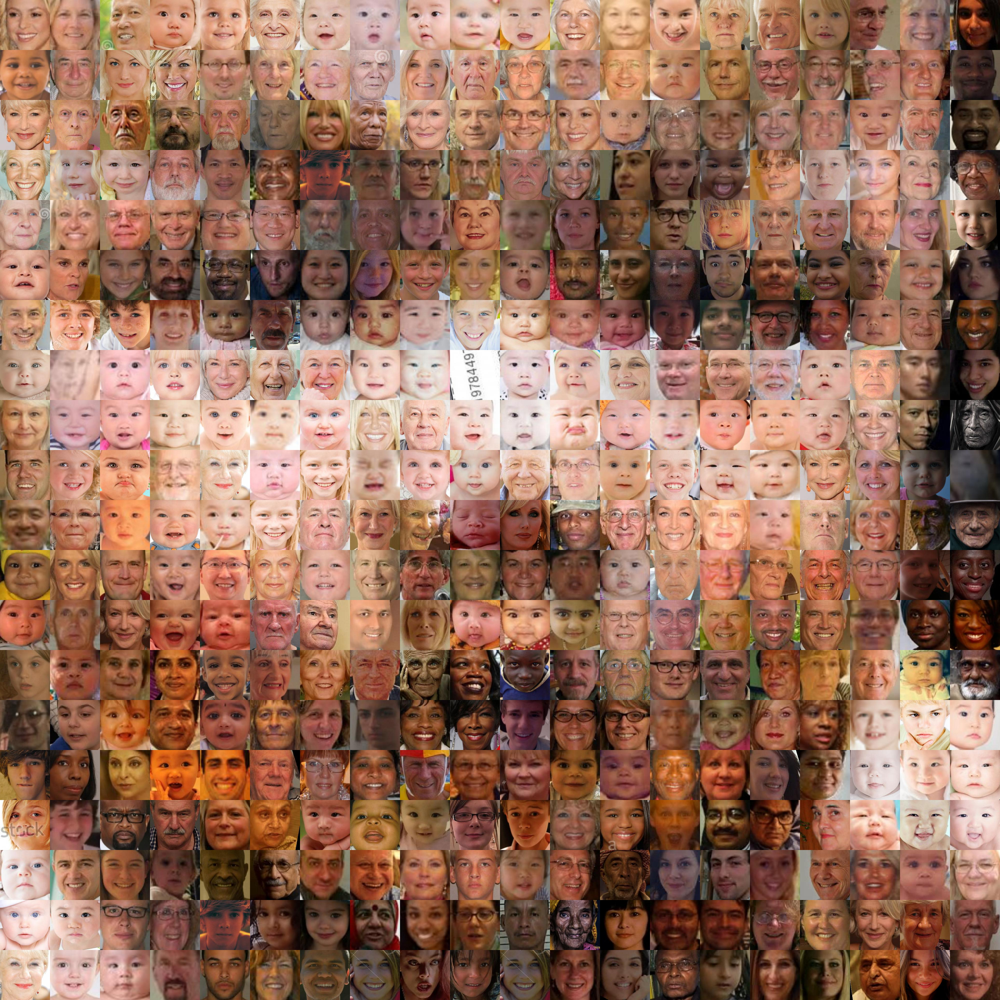

In [11]:
large_mosaic_img